# RubinRhapsodies



Here's all the things you can tweak:


*   frequency_base
*   frequency_low
*   frequency_high
*   square vs. sine drone
*   drone period
*   key
*   instruments

In [1]:
#You may need to go up a directory
import os
os.chdir('..')

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from midi2audio import FluidSynth
from IPython.display import Audio

from utils import configs, rr_utils, rr_plotutils

pygame 2.6.0 (SDL 2.28.4, Python 3.12.4)
Hello from the pygame community. https://www.pygame.org/contribute.html


## Set Params

In [3]:
#defining the bandpasses for all functions
FILTERS = configs.FILTERS
passband = configs.passband
ugrizyC_cb = configs.ugrizyC_cb
INSTRUMENTS = configs.INSTRUMENTS

## Read Data

In [4]:
data, dataMETA = rr_utils.readdata(path={"path": "./",
                                    "data":"data/plasticc_train_lightcurves.csv.gz",
                                    "metadata":"data/plasticc_train_metadata.csv.gz"})

## DEFINITION OF INSTRUMENTS

available instruments
'accordion','acoustic bass','acoustic grand piano','acoustic guitar (nylon)','acoustic guitar (steel)','agogo','alto sax',    'applause', 'bagpipe', 'banjo', 'baritone sax', 'bassoon', 'bird tweet', 'blown bottle', 'brass section', 'breath noise', 'bright acoustic piano', 'celesta', 'cello', 'choir aahs', 'church organ', 'clarinet', 'clavi', 'contrabass', 'distortion guitar', 'drawbar organ', 'dulcimer', 'electric bass (finger)', 'electric bass (pick)', 'electric grand piano', 'electric guitar (clean)', 'electric guitar (jazz)', 'electric guitar (muted)', 'electric piano 1', 'electric piano 2', 'english horn', 'fiddle', 'flute', 'french horn', 'fretless bass', 'fx 1 (rain)', 'fx 2 (soundtrack)', 'fx 3 (crystal)', 'fx 4 (atmosphere)', 'fx 5 (brightness)', 'fx 6 (goblins)', 'fx 7 (echoes)', 'fx 8 (sci-fi)', 'glockenspiel', 'guitar fret noise', 'guitar harmonics', 'gunshot', 'harmonica', 'harpsichord', 'helicopter', 'honky-tonk piano', 'kalimba', 'koto', 'lead 1 (square)', 'lead 2 (sawtooth)', 'lead 3 (calliope)', 'lead 4 (chiff)', 'lead 5 (charang)', 'lead 6 (voice)', 'lead 7 (fifths)', 'lead 8 (bass + lead)', 'marimba', 'melodic tom', 'music box', 'muted trumpet', 'oboe', 'ocarina', 'orchestra hit', 'orchestral harp', 'overdriven guitar', 'pad 1 (new age)', 'pad 2 (warm)', 'pad 3 (polysynth)', 'pad 4 (choir)', 'pad 5 (bowed)', 'pad 6 (metallic)', 'pad 7 (halo)', 'pad 8 (sweep)', 'pan flute', 'percussive organ', 'piccolo', 'pizzicato strings', 'recorder', 'reed organ', 'reverse cymbal', 'rock organ', 'seashore', 'shakuhachi', 'shamisen', 'shanai', 'sitar', 'slap bass 1', 'slap bass 2', 'soprano sax', 'steel drums', 'string ensemble 1', 'string ensemble 2', 'synth bass 1', 'synth bass 2', 'synth drum', 'synth voice', 'synthbrass 1', 'synthbrass 2', 'synthstrings 1', 'synthstrings 2', 'taiko drum', 'tango accordion', 'telephone ring', 'tenor sax', 'timpani', 'tinkle bell', 'tremolo strings', 'trombone', 'trumpet', 'tuba', 'tubular bells', 'vibraphone', 'viola', 'violin', 'voice oohs', 'whistle', 'woodblock', 'xylophone'

There are also several percussions

In [5]:
#Set instrument list manually

INSTRUMENTS = {'u':'clarinet',
               'g':'trumpet',
               'r':'violin',
               'i':'cello',
               'z':'french horn',
               'y':'tinkle bell'}

INSTRUMENTS

{'u': 'clarinet',
 'g': 'trumpet',
 'r': 'violin',
 'i': 'cello',
 'z': 'french horn',
 'y': 'tinkle bell'}

**Instruments chosen**
A band-pass filter works to screen out wavelengths of light that are too low or too high, allowing only wavelengths within a certain range to pass through. In the LSST photometric system, the 6 filters are labeled 'u','g','r','i','z','y'.
These filters range from highest pitches,ug, to mid range pitches,iz, to lowest pitches, zy.

Piccolo: The piccolo is a small flute-like instrument known for its incredibly high pitch, often used to play the highest melodies in orchestral compositions.

Glockenspiel: a percussion instrument consisting of a series of graduated metal bars tuned to the chromatic scale and played with two hammers

Alto Saxophone: As the name suggests, the alto saxophone is a mid-range instrument commonly used in jazz, classical, and popular music.

Acoustic Guitar Nylon: The nylon-stringed acoustic guitar typically covers a mid-range pitch and is widely used in various music genres.


Tuba: The tuba, a large brass instrument, is known for producing the lowest pitches in the brass family.

Contrabass: The contrabass, or double bass, is the largest and lowest-pitched instrument in the string family, often providing the foundational bass in ensembles.

It's important to note that the actual pitch range of an instrument can vary depending on its specific design, playing technique, and musical context. In an orchestra or ensemble setting, instruments with different pitch ranges work together to create a harmonious and balanced sound.


find the supernovae Ibc and the eclipsing binaries and identify the associated data

In [6]:
singlePlotObject = rr_plotutils.singlePlotObject
multiPlotObject = rr_plotutils.multiPlotObject
singleSonification = rr_utils.singleSonification
multiSonification = rr_utils.multiSonification

## Visualization

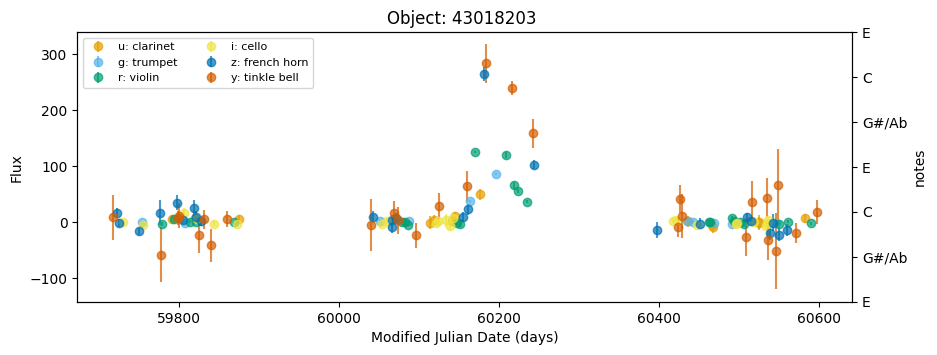

In [7]:
#Inspect a SNe Type Ibc lightcurve

objectid = 43018203

multiPlotObject(data, objectid, instruments=INSTRUMENTS);

## Sonificiations

### listen to u band only

now plotting


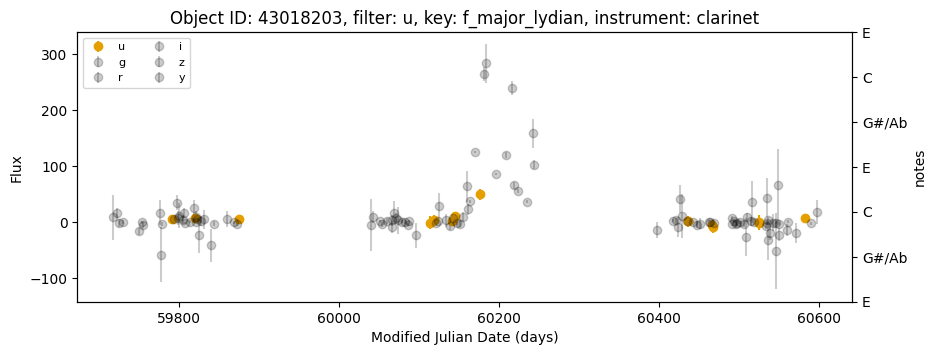

Saving to midi file
FluidSynth runtime version 2.3.5
Copyright (C) 2000-2024 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of Creative Technology Ltd.

Rendering audio to file 'view/waveoutput_u.wav'..


In [9]:
thisband = 'u'

singleSonification(data, objectid, filter=thisband, key='f_major_lydian',
                                instrument=INSTRUMENTS[thisband],
                                transposing=False, rescaled=True,
                                save=False, plot=True, colab=True,
                   diagonsticplots=False)

fs = FluidSynth(sound_font='font.sf2')
fs.midi_to_audio('view/midioutput.mid', 'view/waveoutput_u.wav')
Audio('view/waveoutput_u.wav')

### listen to g band only

now plotting


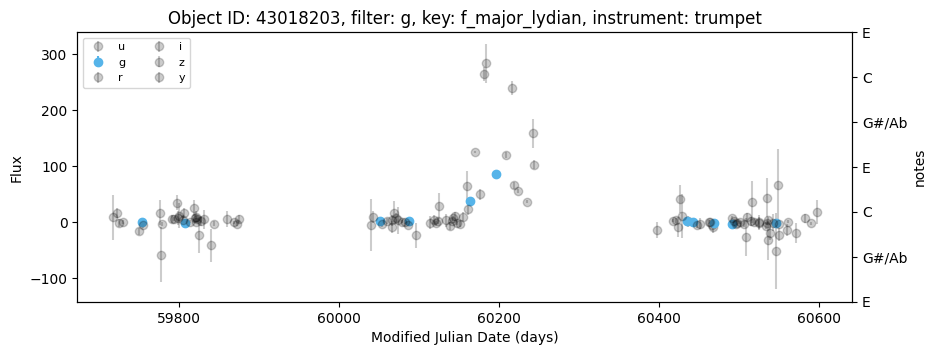

Saving to midi file
FluidSynth runtime version 2.3.5
Copyright (C) 2000-2024 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of Creative Technology Ltd.

Rendering audio to file 'view/waveoutput_g.wav'..


In [9]:
#@title Default title text
thisband = 'g'

singleSonification(data, objectid, filter=thisband, key='f_major_lydian',
                                instrument=INSTRUMENTS[thisband],
                                transposing=True, rescaled=True,
                                save=False, plot=True, colab=True,
                   diagonsticplots=False)
fs = FluidSynth(sound_font='font.sf2')
fs.midi_to_audio('view/midioutput.mid', 'view/waveoutput_g.wav')
Audio('view/waveoutput_g.wav')

### listen to r band only

now plotting


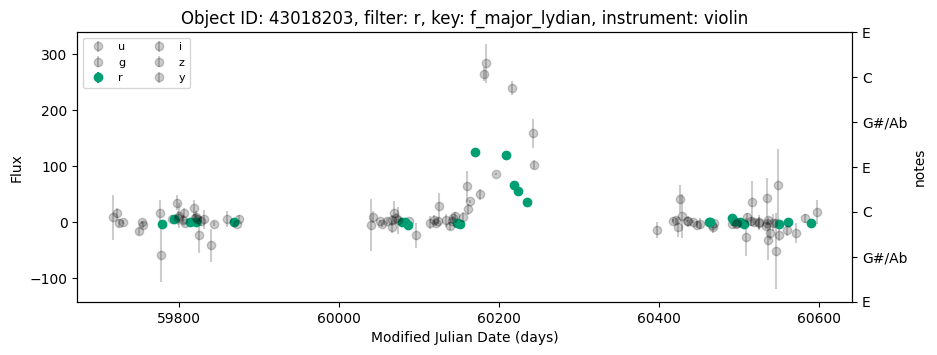

Saving to midi file
FluidSynth runtime version 2.3.5
Copyright (C) 2000-2024 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of Creative Technology Ltd.

Rendering audio to file 'view/waveoutput_r.wav'..


In [10]:
thisband = 'r'
singleSonification(data, objectid, filter=thisband, key='f_major_lydian',
                                instrument=INSTRUMENTS[thisband],
                                transposing=True, rescaled=True,
                                save=False, plot=True, colab=True,
                   diagonsticplots=False)
fs = FluidSynth(sound_font='font.sf2')
fs.midi_to_audio('view/midioutput.mid', 'view/waveoutput_r.wav')
Audio('view/waveoutput_r.wav')

### listen to i band only

now plotting


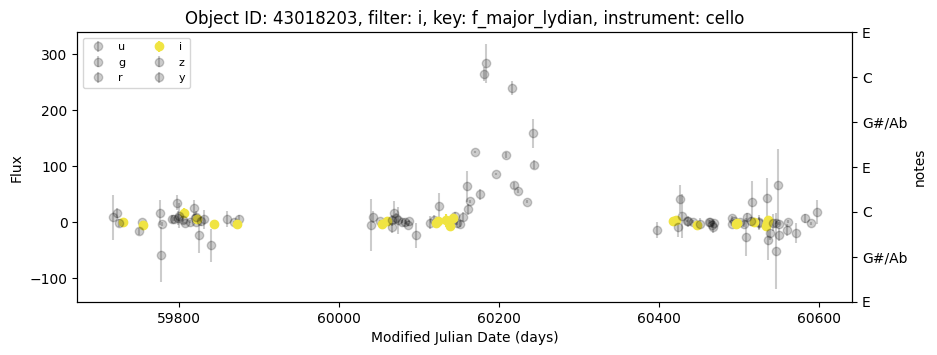

Saving to midi file
FluidSynth runtime version 2.3.5
Copyright (C) 2000-2024 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of Creative Technology Ltd.

Rendering audio to file 'view/waveoutput_i.wav'..


In [11]:
thisband = 'i'
singleSonification(data, objectid, filter=thisband, key='f_major_lydian',
                                instrument=INSTRUMENTS[thisband],
                                transposing=True, rescaled=True,
                                save=False, plot=True, colab=True,
                   diagonsticplots=False)
fs = FluidSynth(sound_font='font.sf2')
fs.midi_to_audio('view/midioutput.mid', 'view/waveoutput_i.wav')
Audio('view/waveoutput_i.wav')

### listen to z band only

now plotting


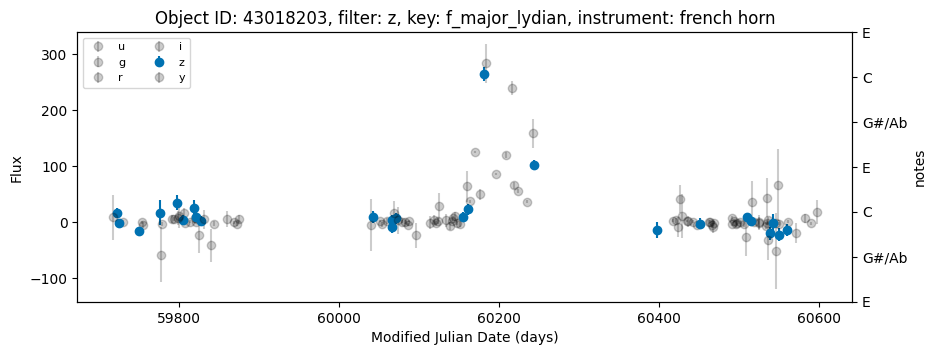

Saving to midi file
FluidSynth runtime version 2.3.5
Copyright (C) 2000-2024 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of Creative Technology Ltd.

Rendering audio to file 'view/waveoutput_z.wav'..


In [12]:
thisband = 'z'
singleSonification(data, objectid, filter=thisband, key='f_major_lydian',
                                instrument=INSTRUMENTS[thisband],
                                transposing=True, rescaled=True,
                                save=False, plot=True, colab=True,
                   diagonsticplots=False)
fs = FluidSynth(sound_font='font.sf2')
fs.midi_to_audio('view/midioutput.mid', 'view/waveoutput_z.wav')
Audio('view/waveoutput_z.wav')

### listen to y band only

now plotting


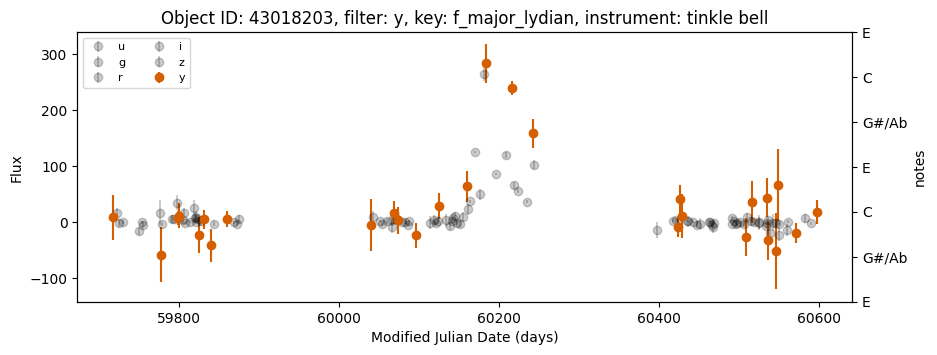

Saving to midi file
FluidSynth runtime version 2.3.5
Copyright (C) 2000-2024 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of Creative Technology Ltd.

Rendering audio to file 'view/waveoutput_y.wav'..


In [13]:
thisband = 'y'
singleSonification(data, objectid, filter=thisband, key='f_major_lydian',
                                instrument=INSTRUMENTS[thisband],
                                transposing=True, rescaled=True,
                                save=False, plot=True, colab=True,
                   diagonsticplots=False)
fs = FluidSynth(sound_font='font.sf2')
fs.midi_to_audio('view/midioutput.mid', 'view/waveoutput_y.wav')
Audio('view/waveoutput_y.wav')

----

### All violins

now plotting


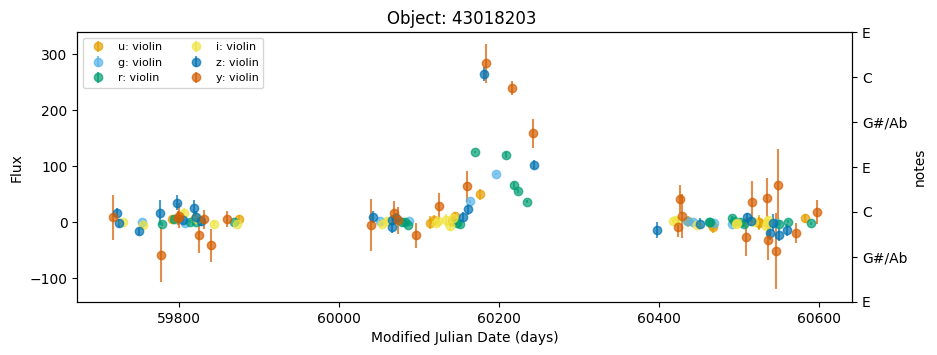

<Figure size 640x480 with 0 Axes>

Saving to midi file
FluidSynth runtime version 2.3.5
Copyright (C) 2000-2024 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of Creative Technology Ltd.

Rendering audio to file 'view/waveoutput_violins.wav'..


In [14]:
#----Sonification Knobs
temp_instruments = {p:'violin' for p in FILTERS}
#----

multiSonification(data, objectid,
                                instruments=temp_instruments,
                                transposing=True, rescaled=True,
                                drone=None, drum=None,
                                save=False, plot=True, colab=True)
fs = FluidSynth(sound_font='font.sf2')
fs.midi_to_audio('view/midioutput.mid', 'view/waveoutput_violins.wav')
Audio('view/waveoutput_violins.wav')

### All Different Instruments

In [15]:
for i in FILTERS:
  print(i, INSTRUMENTS[i])

u clarinet
g trumpet
r violin
i cello
z french horn
y tinkle bell


now plotting


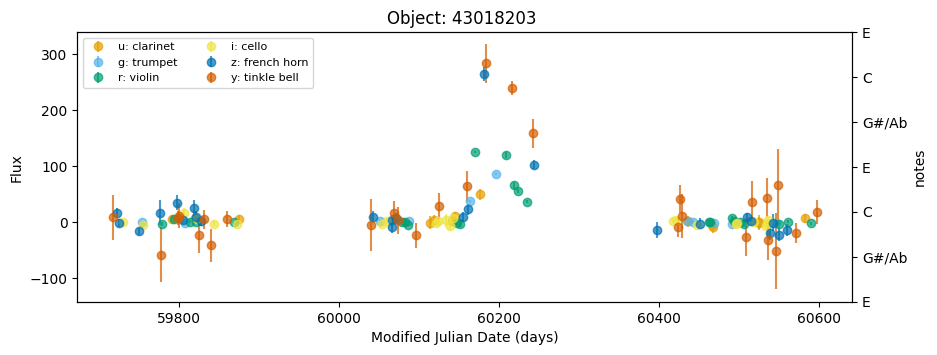

<Figure size 640x480 with 0 Axes>

Saving to midi file
FluidSynth runtime version 2.3.5
Copyright (C) 2000-2024 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of Creative Technology Ltd.

Rendering audio to file 'view/waveoutput_transpose.wav'..


In [16]:
multiSonification(data, objectid, key='f_major_lydian',
                                instruments=INSTRUMENTS,
                                transposing=True, rescaled=True,
                                drone=None, drum=None,
                                save=False, plot=True, colab=True)

fs = FluidSynth(sound_font='font.sf2')
fs.midi_to_audio('view/midioutput.mid', 'view/waveoutput_transpose.wav')
Audio('view/waveoutput_transpose.wav')

## Drones

In [17]:
objectid = 43018203

now plotting


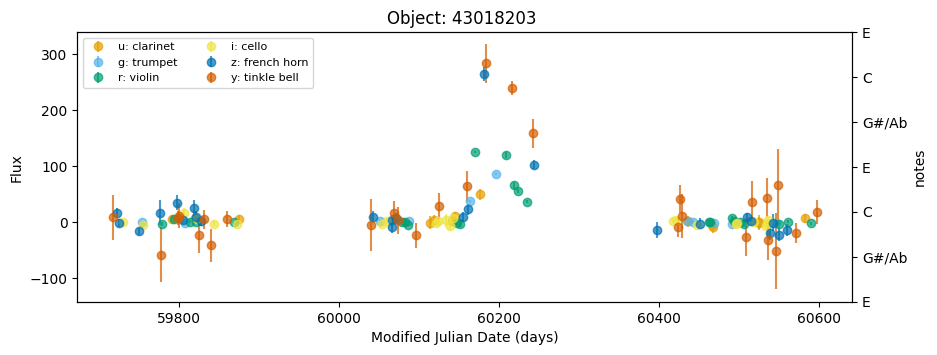

<Figure size 640x480 with 0 Axes>

Saving to midi file
FluidSynth runtime version 2.3.5
Copyright (C) 2000-2024 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of Creative Technology Ltd.

Rendering audio to file 'view/waveoutput_dronestep.wav'..


In [18]:
multiSonification(data, objectid, key='f_major_lydian',
                                instruments=INSTRUMENTS,
                                transposing=True, rescaled=True,
                                drone="step", drum=None,
                                save=False, plot=True, colab=True)

fs = FluidSynth(sound_font='font.sf2')
fs.midi_to_audio('view/midioutput.mid', 'view/waveoutput_dronestep.wav')
Audio('view/waveoutput_dronestep.wav')

now plotting


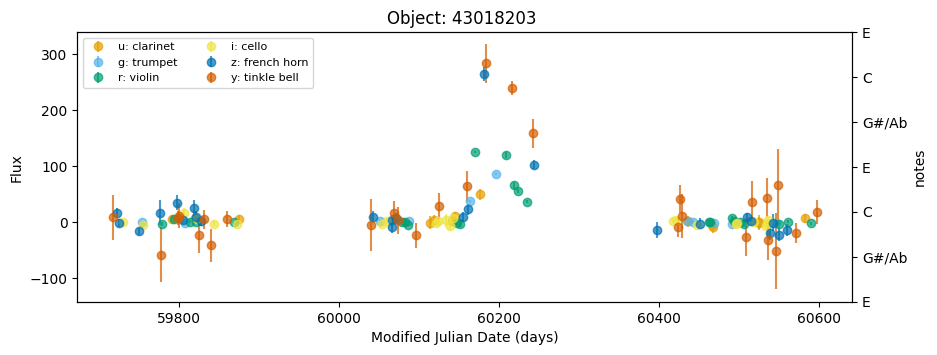

<Figure size 640x480 with 0 Axes>

Saving to midi file
FluidSynth runtime version 2.3.5
Copyright (C) 2000-2024 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of Creative Technology Ltd.

Rendering audio to file 'view/waveoutput_dronegliss.wav'..


In [19]:
multiSonification(data, objectid,
                                instruments=INSTRUMENTS,
                                transposing=True, rescaled=True,
                                drone="gliss", drone_vol=100, drum=None,
                                save=False, plot=True, colab=True)

fs = FluidSynth(sound_font='font.sf2')
fs.midi_to_audio('view/midioutput.mid', 'view/waveoutput_dronegliss.wav')
Audio('view/waveoutput_dronegliss.wav')

## Drums

In [20]:
for i in FILTERS:
  print(i, INSTRUMENTS[i])

u clarinet
g trumpet
r violin
i cello
z french horn
y tinkle bell


now plotting


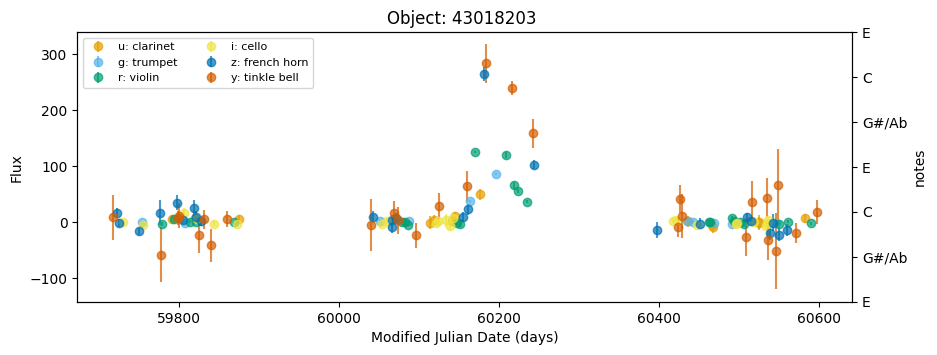

<Figure size 640x480 with 0 Axes>

Saving to midi file
FluidSynth runtime version 2.3.5
Copyright (C) 2000-2024 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of Creative Technology Ltd.

Rendering audio to file 'view/waveoutput.wav'..


In [21]:
multiSonification(data, objectid, key=configs.KEY,
                                instruments=INSTRUMENTS,
                                transposing=True, rescaled=True,
                                drone="gliss", drone_vol=100, drum='crash cymbal 1',
                                save=False, plot=True, colab=True)

fs = FluidSynth(sound_font='font.sf2')
fs.midi_to_audio('view/midioutput.mid', 'view/waveoutput.wav')
Audio('view/waveoutput.wav')